In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn import metrics
from sklearn.datasets import make_blobs
from mpl_toolkits.basemap import Basemap
from pylab import rcParams
from sklearn import metrics
from datetime import datetime

In [115]:
#Use combine gear dataset for DBSCAN clustering
df = pd.read_csv('../data/combine_gear_v1.csv')
df["timestamp"] = pd.to_datetime(df['timestamp'], unit='s').dt.year

df_sample = df[df['timestamp'] == 2014]
df_sample = df_sample[['lat_x', 'lon_x']]
df_sample

,lat_x,lon_x
11873,-25.842066,-37.088501
11874,-25.995142,-37.196579
51426,-18.297068,178.788162
51427,-18.298515,178.787781
51428,-18.300993,178.787155
...,...,...
456663,8.901003,-79.500732
456664,8.901352,-79.500671
456665,8.900483,-79.501579
456666,8.900494,-79.501251


In [116]:
df_fishing = df_sample[df['is_fishing'] == 1]
df_use = df_fishing[['lat_x', 'lon_x']]

print(df_use.min())
print(df_use.max())

lat_x    -45.302502
lon_x   -179.916824
dtype: float64
lat_x     77.688599
lon_x    179.970154
dtype: float64


<ipython-input-116-037b78f4a8b6>:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



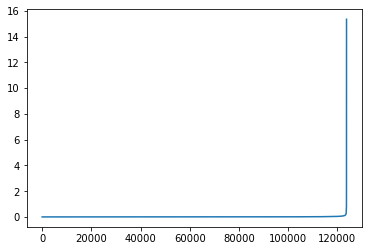

In [117]:
#Use KNN to give some idea how to choose eps in DBSCAN
neigh = NearestNeighbors(n_neighbors = 2)
nbrs = neigh.fit(df_use)
distances, indices = nbrs.kneighbors(df_use)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
#print(distances[223200:225000])
plt.plot(distances)

In [118]:
#kms_per_radian = 6371.0088
epsilon = 0.1
min_samples = 200
db = DBSCAN(eps=epsilon, min_samples=min_samples, algorithm='ball_tree', metric='haversine').fit(df_use)
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

In [119]:
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)


Estimated number of clusters: 5
Estimated number of noise points: 1916


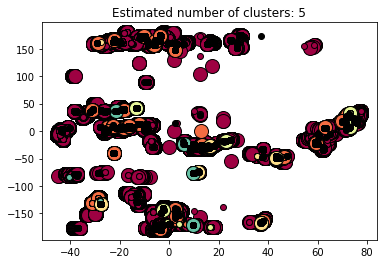

In [120]:
unique_labels = set(labels)
colors = [plt.cm.Spectral(each)
          for each in np.linspace(0, 1, len(unique_labels))]
for k, col in zip(unique_labels, colors):
    if k == -1:
        # Black used for noise.
        col = [0, 0, 0, 1]

    class_member_mask = (labels == k)

    xy = df_use[class_member_mask & core_samples_mask]
    plt.plot(xy.iloc[:,0], xy.iloc[:,1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=14)

    xy = df_use[class_member_mask & ~core_samples_mask]
    plt.plot(xy.iloc[:,0], xy.iloc[:,1], 'o', markerfacecolor=tuple(col),
             markeredgecolor='k', markersize=6)

plt.title('Estimated number of clusters: %d' % n_clusters_)
plt.show()

In [121]:
df_use['Cluster_db'] = labels
clusterNum = len(set(labels))
df_use1 = df_use[df_use['Cluster_db'] > 0] 
df_use1.head()

,lat_x,lon_x,Cluster_db
53934,-6.112790,157.517731,1
53935,-6.112795,157.517700,1
54015,-5.780765,157.523056,1
54016,-5.779925,157.523056,1
54017,-5.779720,157.523041,1


In [129]:
import plotly.graph_objects as go

target =df_use['Cluster_db']
x = df_use['lat_x']
y = df_use['lon_x']

fig = go.Figure(go.Densitymapbox(lat=x, lon=y, z=target, radius=8, colorscale="Sunset", zmin=0, zmax=4))
fig.update_layout(mapbox_style="carto-darkmatter", mapbox_center_lon=180)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [130]:
import altair as alt
from altair import *
from vega_datasets import data
alt.data_transformers.disable_max_rows()
countries = alt.topo_feature(data.world_110m.url, 'countries')
background = alt.Chart(countries).mark_geoshape(
    fill='lightgray',
    stroke='white'
).project(
    "equirectangular"
).properties(
    width=500,
    height=300
)
points = alt.Chart(df_use).mark_point().encode(x='lat_x',y='lon_x', color='Cluster_db')

background + points

alt.LayerChart(...)

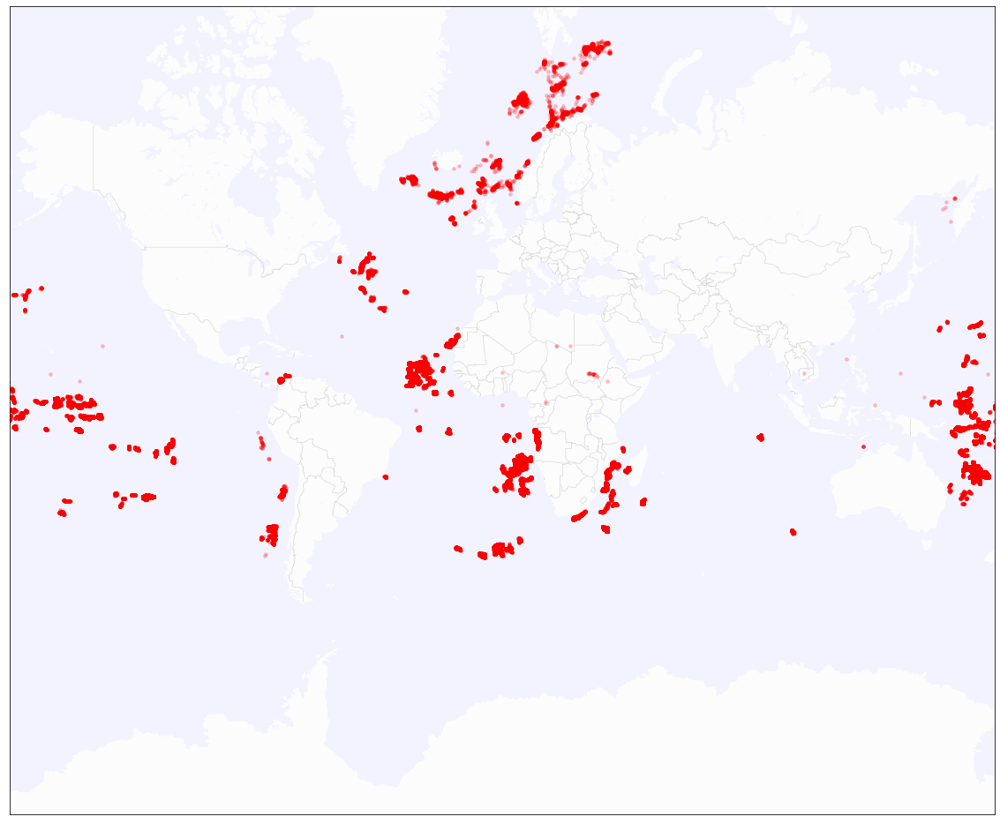

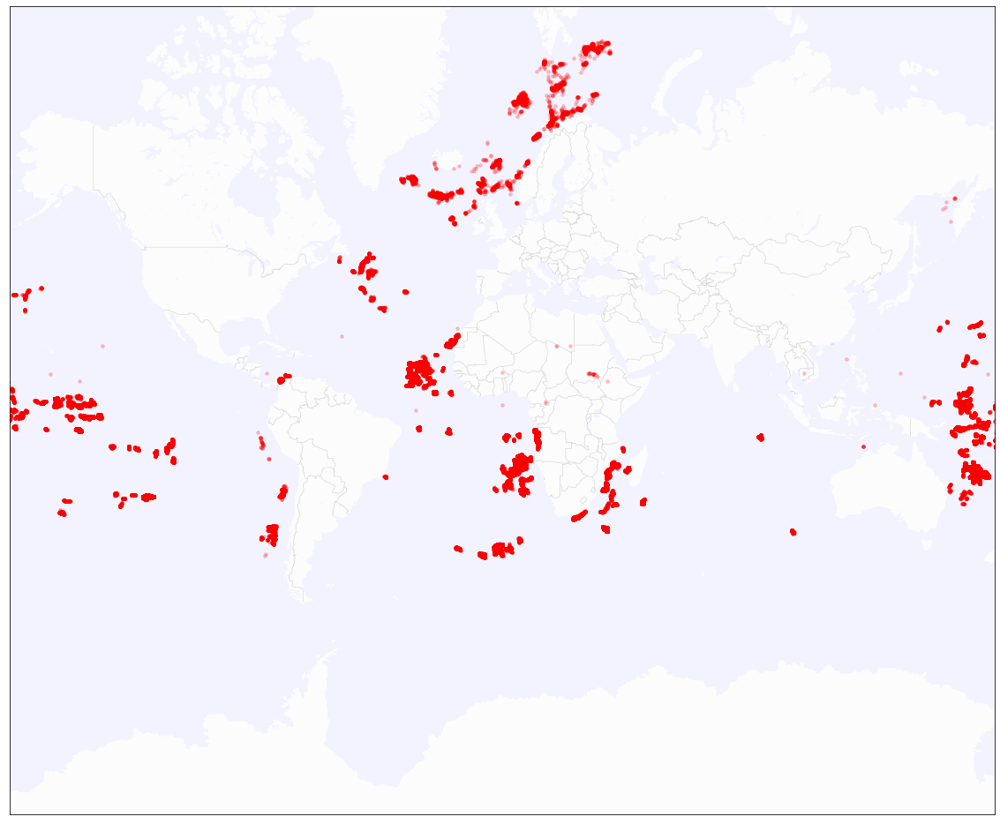

In [131]:
fig, ax = plt.subplots(figsize=(20, 20))

map = Basemap(
    projection = 'merc',
    llcrnrlat=-80,
    llcrnrlon=-170,
    urcrnrlat=80,
    urcrnrlon=170,
    resolution='l'
)
map.drawcountries(color='#cccccc')
map.drawlsmask(ocean_color='b', alpha=0.05)

x, y = map(list(df_use['lon_x']),
         list(df_use['lat_x']))

map.scatter(x,y,50,marker='.',color='r',alpha=0.2,ax=ax)

fig
